**Modelo MobileNetV2 - Version 2**

In [ ]:
!df -h

Filesystem      Size  Used Avail Use% Mounted on
overlay         167G   40G  127G  24% /
tmpfs            64M     0   64M   0% /dev
shm             5.7G     0  5.7G   0% /dev/shm
/dev/root       2.0G  1.2G  817M  59% /sbin/docker-init
tmpfs           6.4G   32K  6.4G   1% /var/colab
/dev/sda1       174G   43G  131G  25% /opt/bin/.nvidia
tmpfs           6.4G     0  6.4G   0% /proc/acpi
tmpfs           6.4G     0  6.4G   0% /proc/scsi
tmpfs           6.4G     0  6.4G   0% /sys/firmware
drive            15G   13G  2.2G  86% /content/gdrive


In [ ]:
!free -h

              total        used        free      shared  buff/cache   available
Mem:            12G        1.0G        9.6G        1.2M        2.1G         11G
Swap:            0B          0B          0B


In [ ]:
!ls -ltr /content/gdrive/MyDrive/tfm/version2/train_dir

total 152
drwx------ 2 root root 4096 Feb  8 22:30  Apple___Apple_scab
drwx------ 2 root root 4096 Feb  8 22:30  Apple___Black_rot
drwx------ 2 root root 4096 Feb  8 22:30  Apple___Cedar_apple_rust
drwx------ 2 root root 4096 Feb  8 22:30  Apple___healthy
drwx------ 2 root root 4096 Feb  8 22:31  Blueberry___healthy
drwx------ 2 root root 4096 Feb  8 22:31  Cherry___healthy
drwx------ 2 root root 4096 Feb  8 22:31  Cherry___Powdery_mildew
drwx------ 2 root root 4096 Feb  8 22:31 'Corn___Cercospora_leaf_spot Gray_leaf_spot'
drwx------ 2 root root 4096 Feb  8 22:32  Corn___Common_rust
drwx------ 2 root root 4096 Feb  8 22:32  Corn___healthy
drwx------ 2 root root 4096 Feb  8 22:32  Corn___Northern_Leaf_Blight
drwx------ 2 root root 4096 Feb  8 22:32  Grape___Black_rot
drwx------ 2 root root 4096 Feb  8 22:32 'Grape___Esca_(Black_Measles)'
drwx------ 2 root root 4096 Feb  8 22:32  Grape___healthy
drwx------ 2 root root 4096 Feb  8 22:32 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)'
drwx---

In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Mon Mar 21 11:39:35 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   37C    P0    26W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
!nvidia-smi -q -i 0 | grep "Product Name"

    Product Name                          : Tesla P100-PCIE-16GB


In [ ]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('To enable a high-RAM runtime, select the Runtime > "Change runtime type"')
  print('menu, and then select High-RAM in the Runtime shape dropdown. Then, ')
  print('re-execute this cell.')
else:
  print('You are using a high-RAM runtime!')

Your runtime has 13.6 gigabytes of available RAM

To enable a high-RAM runtime, select the Runtime > "Change runtime type"
menu, and then select High-RAM in the Runtime shape dropdown. Then, 
re-execute this cell.


In [ ]:
# Import libraries

# Librerias comunes
import pandas as pd
import numpy as np
import os, math, random
from datetime import datetime as dt
import datetime

# Librerias keras y tensorflow

from tensorflow import keras
import tensorflow as tf
from keras.layers import Input, Dense,GlobalAveragePooling2D,BatchNormalization,Dropout
from keras.preprocessing import image
from keras.preprocessing.image import ImageDataGenerator
from keras import preprocessing
from keras.models import Model, Sequential
from tensorflow.keras.optimizers import Adam
from keras.models import load_model

from tensorflow.keras import optimizers
from tensorflow.keras.optimizers import schedules

# Librerias de MobileNet
from keras.applications import mobilenet_v2
#from keras.applications import mobilenet

# Librerias para visualizar las imágenes
%matplotlib inline
import matplotlib.pyplot as plt
from PIL import Image

seed = 1234

In [ ]:
print(f'Versión de tensorflow: {tf.__version__}')

Versión de tensorflow: 2.8.0


In [ ]:
from tensorflow.python.client import device_lib
device_lib.list_local_devices()

[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 11557711230500442017
 xla_global_id: -1, name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 16154099712
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 16878843558568782541
 physical_device_desc: "device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0"
 xla_global_id: 416903419]

In [ ]:
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

Num GPUs Available:  1


In [ ]:
# Inicialización de directorios

model_saved_dir = '/content/gdrive/MyDrive/tfm/models/mobilenetV2/v2-05-MobileNetV2-model'

train_dir = '/content/gdrive/MyDrive/tfm/version2/train_dir/'
test_dir = '/content/gdrive/MyDrive/tfm/version2/test_dir/'
val_dir = '/content/gdrive/MyDrive/tfm/version2/val_dir/'

In [ ]:
# Función para visualizar una imagen

def get_subplot_grid(mylist, columns, figwidth, figheight):
    plot_rows = math.ceil(len(mylist) / columns)
    fig, ax = plt.subplots(plot_rows, columns, sharey=True, sharex=False)
    fig.set_figwidth(figwidth)
    fig.set_figheight(figheight)
    fig.subplots_adjust(hspace=0.1)
    axflat = ax.flat
    #remove the unused subplot, if any
    for ax in axflat[ax.size - 1:len(mylist) - 1:-1]:
        ax.set_visible(False)

    return fig, axflat

In [ ]:
# tamaño de las imagenes: InceptionV3 necesita las dimensiones (224x224x3)
im_width = 224
im_height = 224
channels=3

In [ ]:
sub_class = os.listdir(train_dir)
n_classes = len(sub_class)

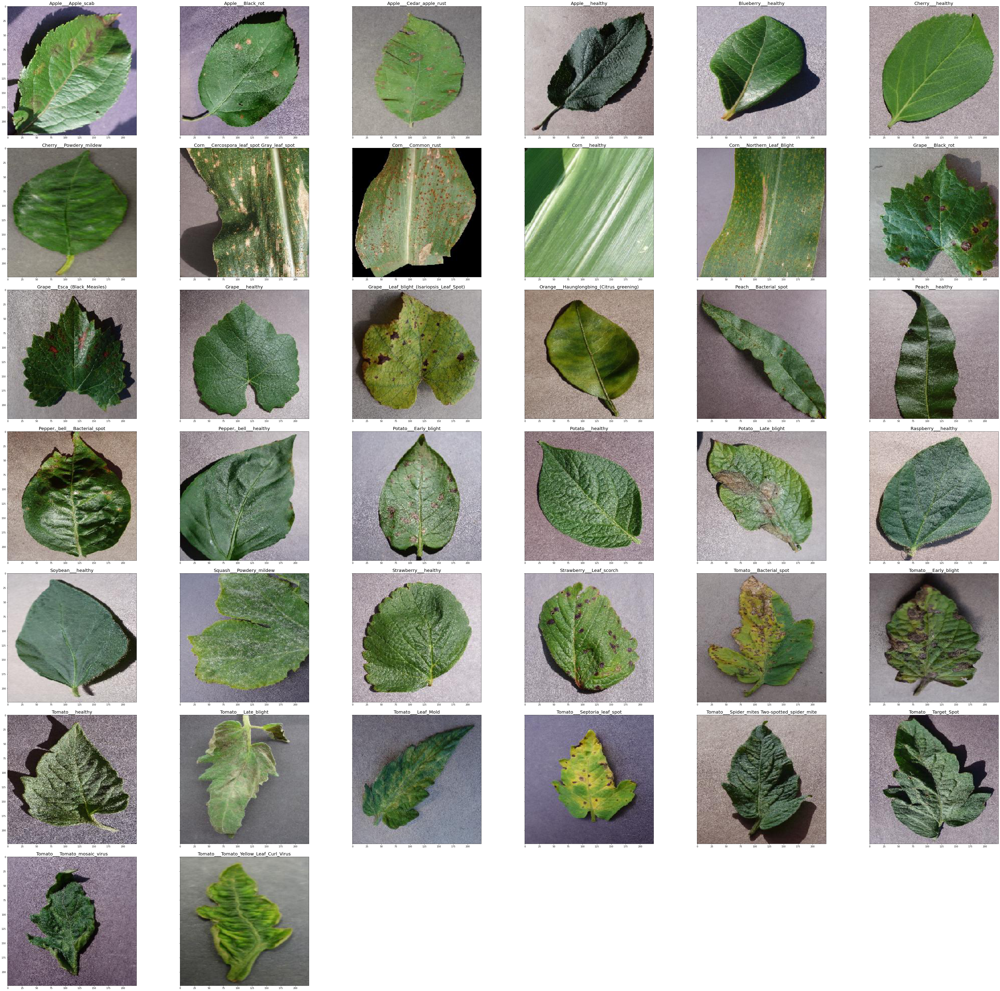

CPU times: user 12.9 s, sys: 273 ms, total: 13.1 s
Wall time: 31.6 s


In [ ]:
# Visualizo una imagen al azar por cada una de las clases del conjunto de imaganes de Train
%%time

test_images_classes = sub_class
test_images=[]

fig, axflat = get_subplot_grid(mylist=test_images_classes, columns=6, figwidth=80, figheight=80)

for idx, label in enumerate(test_images_classes):
    image_folder = os.path.join(train_dir, label)
    image_file = os.path.join(image_folder, random.choice(os.listdir(image_folder)) )
    loaded_image = keras.preprocessing.image.load_img(path=image_file,target_size=(im_width,im_height,channels))
    
    #convert to array and resample dividing by 255
    img_array = keras.preprocessing.image.img_to_array(loaded_image) / 255.
    test_images.append({"idx":idx, "image":img_array, "label": label})
    
    axflat[idx].set_title(label, size=20)
    axflat[idx].imshow(img_array)
plt.show()

In [ ]:
# Incializo los parámetros de batch size y número de épocas para el entrenamiento
# Cuando tenemos imagenes muy grandes necesitamos dividir el proceso de entrenamiento en bloques
# es el numero de imagenes que se entrenarán en cada bloque

batch_size = 32

In [ ]:
# Generacion dataset de train con Data Augmentation

# Es una buena práctica utilizar una división de validación al desarrollar su modelo. 
# Usemos el 80% de las imágenes para entrenamiento y el 20% para validación

# Estandarizar valores para estar en el [0, 1] rango utilizando una capa reescalamiento
train_datagen =  ImageDataGenerator(
    rescale=1/255.0, # con preprocess_input no es necesario hacer el rescalerescale=1/255.0,
    #preprocessing_function=preprocess_input,
    #featurewise_center=False,
    #featurewise_std_normalization=False,
    rotation_range=30,
    width_shift_range=0.2,
    height_shift_range=0.2,
    #shear_range=40,
    zoom_range=0.2,
    vertical_flip=True,
    #fill_mode="nearest",
    brightness_range=[0.5, 1.5]
    #validation_split=0.20
)

# loads the image dataset in memory and generates batches of augmented data
train_generator = train_datagen.flow_from_directory(
  directory=train_dir,
  target_size=(im_width, im_height),
  batch_size=batch_size,
  color_mode='rgb',
  class_mode='categorical'
  #shuffle=True
  #subset='training',
  #seed=SEED
)

Found 41641 images belonging to 38 classes.


In [ ]:
# Muestro el numero de muestras en training de cada una de las clases

#train_generator.classes contains a list of classes of each image
unique_train, counts_train = np.unique(train_generator.classes, return_counts=True)
print ("number of samples per class in training")
dict(zip(train_generator.class_indices, counts_train))


number of samples per class in training


{'Apple___Apple_scab': 441,
 'Apple___Black_rot': 435,
 'Apple___Cedar_apple_rust': 193,
 'Apple___healthy': 1152,
 'Blueberry___healthy': 1052,
 'Cherry___Powdery_mildew': 737,
 'Cherry___healthy': 598,
 'Corn___Cercospora_leaf_spot Gray_leaf_spot': 360,
 'Corn___Common_rust': 835,
 'Corn___Northern_Leaf_Blight': 690,
 'Corn___healthy': 814,
 'Grape___Black_rot': 826,
 'Grape___Esca_(Black_Measles)': 969,
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)': 754,
 'Grape___healthy': 297,
 'Orange___Haunglongbing_(Citrus_greening)': 3858,
 'Peach___Bacterial_spot': 1609,
 'Peach___healthy': 252,
 'Pepper,_bell___Bacterial_spot': 698,
 'Pepper,_bell___healthy': 1035,
 'Potato___Early_blight': 700,
 'Potato___Late_blight': 700,
 'Potato___healthy': 107,
 'Raspberry___healthy': 3868,
 'Soybean___healthy': 3564,
 'Squash___Powdery_mildew': 1285,
 'Strawberry___Leaf_scorch': 776,
 'Strawberry___healthy': 320,
 'Tomato___Bacterial_spot': 1490,
 'Tomato___Early_blight': 700,
 'Tomato___Late_blight':

In [ ]:
# Generación dataset de test

# image transformations are performed while training the model
# hace falta pasar algunos parámetros para hacer Data Augmentation?
test_datagen = ImageDataGenerator(
    rescale=1/255.0 # con preprocess_input no es necesario hacer el rescale
)

test_generator = test_datagen.flow_from_directory(
  directory=test_dir,
  target_size=(im_width, im_height),
  batch_size=batch_size,
  color_mode='rgb',
  class_mode='categorical'
  #shuffle=False
)

Found 10856 images belonging to 38 classes.


In [ ]:
# Muestro el numero de muestras en test de cada una de las clases

unique_test, counts_test = np.unique(test_generator.classes, return_counts=True)
print ("number of samples per class in test")
dict(zip(test_generator.class_indices, counts_test))

number of samples per class in test


{'Apple___Apple_scab': 126,
 'Apple___Black_rot': 124,
 'Apple___Cedar_apple_rust': 55,
 'Apple___healthy': 329,
 'Blueberry___healthy': 300,
 'Cherry___Powdery_mildew': 210,
 'Cherry___healthy': 171,
 'Corn___Cercospora_leaf_spot Gray_leaf_spot': 102,
 'Corn___Common_rust': 238,
 'Corn___Northern_Leaf_Blight': 197,
 'Corn___healthy': 232,
 'Grape___Black_rot': 236,
 'Grape___Esca_(Black_Measles)': 276,
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)': 215,
 'Grape___healthy': 84,
 'Orange___Haunglongbing_(Citrus_greening)': 1100,
 'Peach___Bacterial_spot': 459,
 'Peach___healthy': 72,
 'Pepper,_bell___Bacterial_spot': 200,
 'Pepper,_bell___healthy': 296,
 'Potato___Early_blight': 200,
 'Potato___Late_blight': 200,
 'Potato___healthy': 30,
 'Raspberry___healthy': 74,
 'Soybean___healthy': 1018,
 'Squash___Powdery_mildew': 367,
 'Strawberry___Leaf_scorch': 222,
 'Strawberry___healthy': 91,
 'Tomato___Bacterial_spot': 425,
 'Tomato___Early_blight': 200,
 'Tomato___Late_blight': 383,
 'Tomat

In [ ]:
# Generación dataset de validation

val_datagen = ImageDataGenerator(
    rescale=1/255.0 # con preprocess_input no es necesario hacer el rescale
)

val_generator = val_datagen.flow_from_directory(
  directory=val_dir,
  target_size=(im_width, im_height),
  batch_size=batch_size,
  color_mode='rgb',
  class_mode='categorical'
  #shuffle=False
)

Found 5418 images belonging to 38 classes.


In [ ]:
unique_val, counts_val = np.unique(val_generator.classes, return_counts=True)
print ("number of samples per class in test")
dict(zip(val_generator.class_indices, counts_val))

number of samples per class in test


{'Apple___Apple_scab': 63,
 'Apple___Black_rot': 62,
 'Apple___Cedar_apple_rust': 27,
 'Apple___healthy': 164,
 'Blueberry___healthy': 150,
 'Cherry___Powdery_mildew': 105,
 'Cherry___healthy': 85,
 'Corn___Cercospora_leaf_spot Gray_leaf_spot': 51,
 'Corn___Common_rust': 119,
 'Corn___Northern_Leaf_Blight': 98,
 'Corn___healthy': 116,
 'Grape___Black_rot': 118,
 'Grape___Esca_(Black_Measles)': 138,
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)': 107,
 'Grape___healthy': 42,
 'Orange___Haunglongbing_(Citrus_greening)': 550,
 'Peach___Bacterial_spot': 229,
 'Peach___healthy': 36,
 'Pepper,_bell___Bacterial_spot': 99,
 'Pepper,_bell___healthy': 147,
 'Potato___Early_blight': 100,
 'Potato___Late_blight': 100,
 'Potato___healthy': 15,
 'Raspberry___healthy': 37,
 'Soybean___healthy': 509,
 'Squash___Powdery_mildew': 183,
 'Strawberry___Leaf_scorch': 111,
 'Strawberry___healthy': 45,
 'Tomato___Bacterial_spot': 212,
 'Tomato___Early_blight': 100,
 'Tomato___Late_blight': 191,
 'Tomato___Leaf

Batch shape (input):  (32, 224, 224, 3)
Batch shape (target): (32, 38)


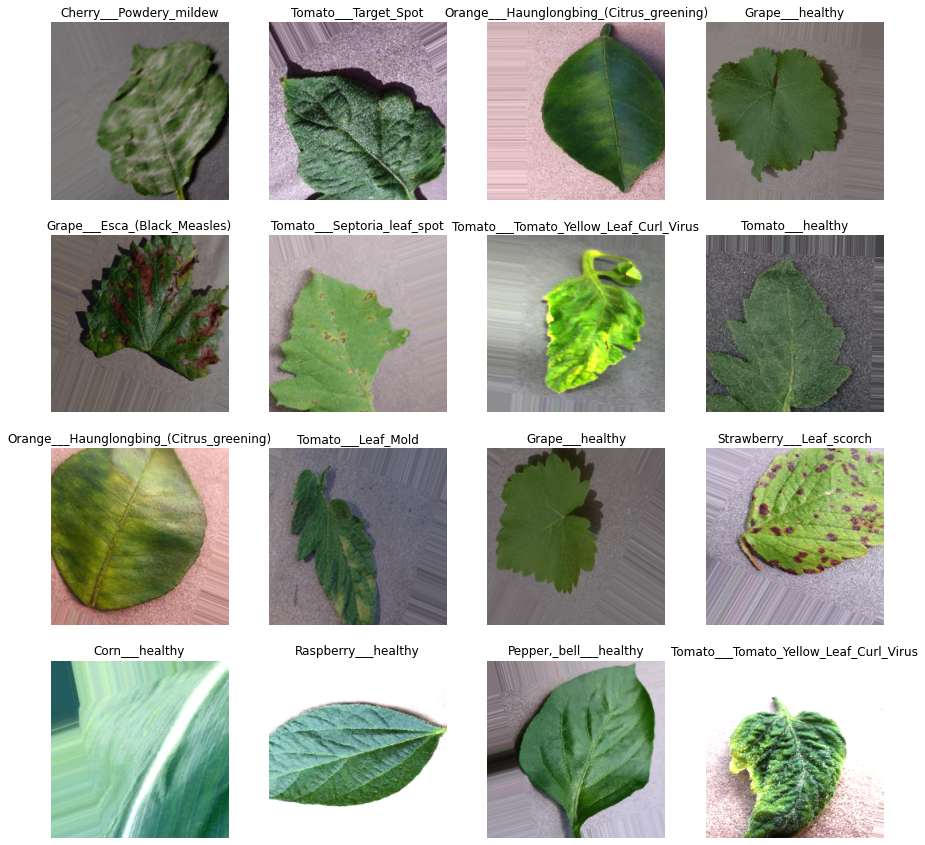

CPU times: user 1.64 s, sys: 67.7 ms, total: 1.71 s
Wall time: 11.4 s


In [ ]:
# Pintar alguno de los datos que estoy tratando aplicando Data Augmentation
%%time 

classes = [k for k, v in train_generator.class_indices.items()]

n_rows = 4
n_cols = 4

for batch_x, batch_y in train_generator:
    print("Batch shape (input): ", batch_x.shape)
    print("Batch shape (target):", batch_y.shape)

    plt.figure(figsize=(15, 15))
    for c, x, y in zip(range(len(batch_x)), batch_x, batch_y):
        if c == n_rows * n_cols:
            break

        plt.subplot(n_rows, n_cols, c + 1)
        plt.imshow(x)
        plt.axis("off")
        plt.title(classes[np.where(y)[0][0]])

    plt.show()
    break

In [ ]:
#input_tensor = Input(shape=(im_width, im_height, channels))

base_model = mobilenet_v2.MobileNetV2(weights='imagenet', 
                                      include_top=False,
                                      input_shape=(im_width, im_height, channels)
                                      )


9420800/9406464 [==============================] - 0s 0us/step


In [ ]:
x = base_model.output

x = GlobalAveragePooling2D()(x)

x = Dense(1024, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.4)(x) 

x = Dense(512, activation='relu')(x)
x = BatchNormalization()(x)

x = Dense(256, activation='relu')(x)

x = Dense(128, activation='relu')(x)

preds = Dense(n_classes, activation='softmax')(x)

model = Model(inputs = base_model.input, outputs = preds)

In [ ]:
#layers_to_freeze = 154

#for layer in base_model.layers:
#    layer.trainable=False

base_model.trainable = False

In [ ]:
lr_schedule = keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=0.001,
    decay_steps=10000,
    decay_rate=0.80,
    staircase=True)

#opt = keras.optimizers.Adam(learning_rate=lr_schedule)
opt = keras.optimizers.Adam()

model.compile(
    loss="categorical_crossentropy",
    optimizer=opt,
    metrics=["accuracy"]
)

In [ ]:

early_stopping = keras.callbacks.EarlyStopping(patience=3, mode='min', monitor='val_loss')
checkpoint = keras.callbacks.ModelCheckpoint(model_saved_dir, save_best_only=True, monitor='val_loss')

In [ ]:
# Se define el tamaño de cada paso en train y en validation como el número total de elementos de train 
# y validation dividido por el tamaño de batch size que he definido inicialmente

epochs = 8
batch_size = 32

step_size_train = train_generator.n//train_generator.batch_size
step_size_test = test_generator.n//test_generator.batch_size
step_size_val = val_generator.n//val_generator.batch_size

In [ ]:
# Transfer learning
%%time

history_tl = model.fit(
    train_generator,
    validation_data=val_generator,
    epochs=epochs,
    steps_per_epoch=step_size_train,
    batch_size=batch_size,
    validation_steps=step_size_val, 
    #validation_split = 0.1,
    callbacks=[early_stopping, checkpoint]
)

Epoch 1/8
1301/1301 [==============================] - 15417s 12s/step - loss: 0.7887 - accuracy: 0.7174 - val_loss: 0.4267 - val_accuracy: 0.8086
Epoch 2/8
1301/1301 [==============================] - 752s 578ms/step - loss: 0.5559 - accuracy: 0.7806 - val_loss: 0.4146 - val_accuracy: 0.8190
Epoch 3/8
1301/1301 [==============================] - 751s 577ms/step - loss: 0.5029 - accuracy: 0.7956 - val_loss: 0.3486 - val_accuracy: 0.8990
Epoch 4/8
1301/1301 [==============================] - 745s 573ms/step - loss: 0.4743 - accuracy: 0.8039 - val_loss: 0.3389 - val_accuracy: 0.8290
Epoch 5/8
1301/1301 [==============================] - 753s 579ms/step - loss: 0.4507 - accuracy: 0.8122 - val_loss: 0.3325 - val_accuracy: 0.8730
Epoch 6/8
1301/1301 [==============================] - 745s 573ms/step - loss: 0.4394 - accuracy: 0.8117 - val_loss: 0.3241 - val_accuracy: 0.9022
Epoch 7/8
1301/1301 [==============================] - 746s 574ms/step - loss: 0.4260 - accuracy: 0.8166 - val_loss: 0

In [ ]:
%%time
[loss, acc] = model.evaluate(test_generator, verbose=0)
print("Test accuracy: %.2f%%" % (100 * acc))
print("Test loss:", loss)

Test accuracy: 87.36%
Test loss: 0.3105233609676361
CPU times: user 43.1 s, sys: 6.07 s, total: 49.1 s
Wall time: 1h 1min 33s


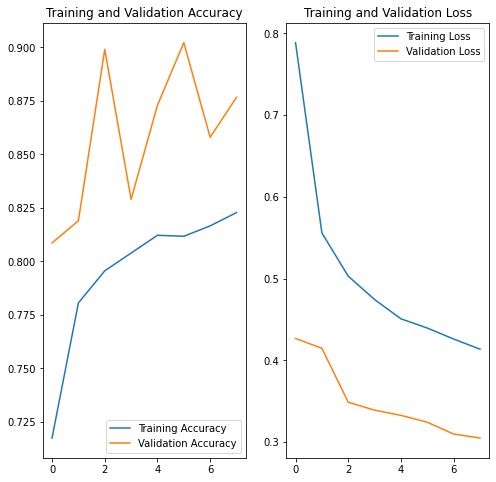

In [ ]:
acc = history_tl.history['accuracy']
val_acc = history_tl.history['val_accuracy']

loss = history_tl.history['loss']
val_loss = history_tl.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

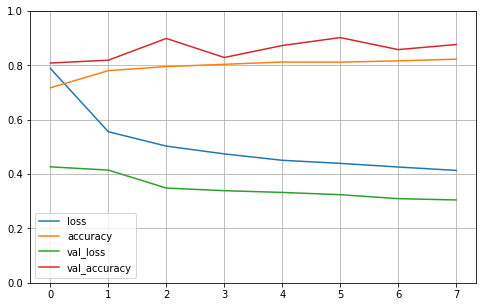

In [ ]:
pd.DataFrame(history_tl.history).plot(figsize=(8,5))
plt.grid(True)
plt.gca().set_ylim(0, 1)
plt.show()

In [ ]:
# Setup to transfer learn

layers_to_freeze = 134

for layer in model.layers[:layers_to_freeze]:
    layer.trainable=False
for layer in model.layers[layers_to_freeze:]:
    layer.trainable=True
    

In [ ]:
lr_schedule = keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=0.001,
    decay_steps=10000,
    decay_rate=0.80,
    staircase=True)

#opt = keras.optimizers.Adam(learning_rate=lr_schedule)
opt = keras.optimizers.Adam()

model.compile(
    loss="categorical_crossentropy",
    optimizer=opt,
    metrics=["accuracy"]
)

In [ ]:
# Configuración de los callbacks para el finetune

early_stopping = keras.callbacks.EarlyStopping(patience=3, mode='min', monitor='val_loss')
checkpoint = keras.callbacks.ModelCheckpoint(model_saved_dir, save_best_only=True, monitor='val_loss')

In [ ]:
epochs = 8
batch_size = 32

step_size_train = train_generator.n//train_generator.batch_size
step_size_test = test_generator.n//test_generator.batch_size
step_size_val = val_generator.n//val_generator.batch_size

In [ ]:
# Fitting/Training the final model
%%time

history_tl = model.fit(
    train_generator,
    validation_data=val_generator,
    epochs=epochs,
    steps_per_epoch=step_size_train,
    batch_size=batch_size,
    validation_steps=step_size_val, 
    #validation_split = 0.1,
    callbacks=[early_stopping, checkpoint]
)

Epoch 1/8
1301/1301 [==============================] - 751s 574ms/step - loss: 0.5381 - accuracy: 0.7873 - val_loss: 1.0387 - val_accuracy: 0.7232
Epoch 2/8
1301/1301 [==============================] - 748s 575ms/step - loss: 0.3852 - accuracy: 0.8306 - val_loss: 0.4906 - val_accuracy: 0.8169
Epoch 3/8
1301/1301 [==============================] - 728s 559ms/step - loss: 0.3504 - accuracy: 0.8426 - val_loss: 0.4918 - val_accuracy: 0.8604
Epoch 4/8
1301/1301 [==============================] - 746s 573ms/step - loss: 0.3222 - accuracy: 0.8518 - val_loss: 0.3570 - val_accuracy: 0.9040
Epoch 5/8
1301/1301 [==============================] - 727s 559ms/step - loss: 0.2998 - accuracy: 0.8583 - val_loss: 0.7481 - val_accuracy: 0.8423
Epoch 6/8
1301/1301 [==============================] - 746s 573ms/step - loss: 0.2890 - accuracy: 0.8620 - val_loss: 0.2886 - val_accuracy: 0.9321
Epoch 7/8
1301/1301 [==============================] - 718s 552ms/step - loss: 0.2828 - accuracy: 0.8634 - val_loss: 0

In [ ]:
%%time
[loss, acc] = model.evaluate(test_generator, verbose=0)
print("Test accuracy: %.2f%%" % (100 * acc))
print("Test loss:", loss)

Test accuracy: 77.63%
Test loss: 0.6492570638656616
CPU times: user 30.6 s, sys: 3.3 s, total: 33.9 s
Wall time: 42 s


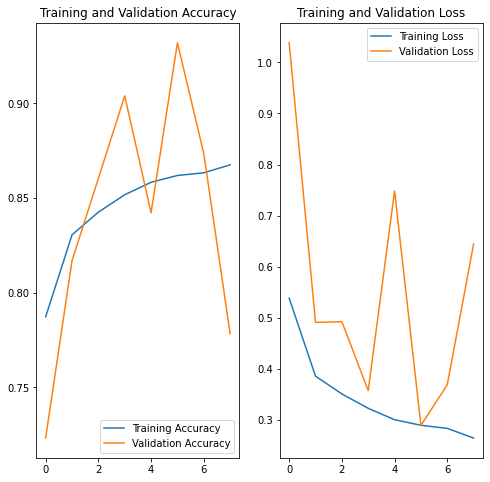

In [ ]:
acc = history_tl.history['accuracy']
val_acc = history_tl.history['val_accuracy']

loss = history_tl.history['loss']
val_loss = history_tl.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

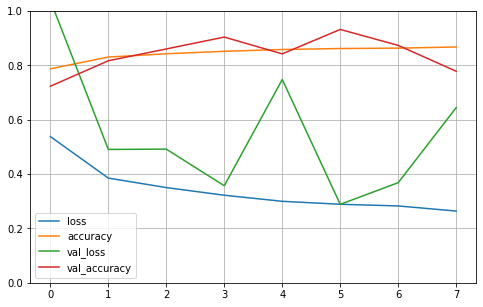

In [ ]:
pd.DataFrame(history_tl.history).plot(figsize=(8,5))
plt.grid(True)
plt.gca().set_ylim(0, 1)
plt.show()

In [ ]:
!ls -ltr /content/gdrive/MyDrive/tfm/models/mobilenetV2/v2-05-MobileNetV2-model

total 3079
drwx------ 2 root root    4096 Feb 19 22:10 assets
drwx------ 2 root root    4096 Mar 21 19:48 variables
-rw------- 1 root root 2781643 Mar 21 19:48 saved_model.pb
-rw------- 1 root root  362854 Mar 21 19:48 keras_metadata.pb


**PREDICCIÓN**

In [ ]:
# Import libraries

import numpy as np
import os
from keras.preprocessing import image
from keras import preprocessing
from keras.models import load_model

# Librerias para visualizar las imágenes
%matplotlib inline
import matplotlib.pyplot as plt

In [ ]:
model_saved_dir = '/content/gdrive/MyDrive/tfm/models/mobilenetV2/v2-05-MobileNetV2-model'

train_dir = '/content/gdrive/MyDrive/tfm/version2/train_dir/'
test_dir = '/content/gdrive/MyDrive/tfm/version2/test_dir/'
val_dir = '/content/gdrive/MyDrive/tfm/version2/val_dir/'

Mounted at /content/gdrive


In [ ]:
%%time

history_ft = load_model(model_saved_dir)

CPU times: user 7.6 s, sys: 846 ms, total: 8.45 s
Wall time: 14.3 s


{'Apple___Apple_scab': '0.00%', 'Apple___Black_rot': '100.00%', 'Apple___Cedar_apple_rust': '0.00%', 'Apple___healthy': '0.00%', 'Blueberry___healthy': '0.00%', 'Cherry___healthy': '0.00%', 'Cherry___Powdery_mildew': '0.00%', 'Corn___Cercospora_leaf_spot Gray_leaf_spot': '0.00%', 'Corn___Common_rust': '0.00%', 'Corn___healthy': '0.00%', 'Corn___Northern_Leaf_Blight': '0.00%', 'Grape___Black_rot': '0.00%', 'Grape___Esca_(Black_Measles)': '0.00%', 'Grape___healthy': '0.00%', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)': '0.00%', 'Orange___Haunglongbing_(Citrus_greening)': '0.00%', 'Peach___Bacterial_spot': '0.00%', 'Peach___healthy': '0.00%', 'Pepper,_bell___Bacterial_spot': '0.00%', 'Pepper,_bell___healthy': '0.00%', 'Potato___Early_blight': '0.00%', 'Potato___healthy': '0.00%', 'Potato___Late_blight': '0.00%', 'Raspberry___healthy': '0.00%', 'Soybean___healthy': '0.00%', 'Squash___Powdery_mildew': '0.00%', 'Strawberry___healthy': '0.00%', 'Strawberry___Leaf_scorch': '0.00%', 'Tomato___

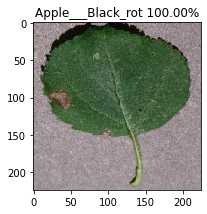

CPU times: user 269 ms, sys: 8.62 ms, total: 278 ms
Wall time: 303 ms


<Figure size 432x288 with 0 Axes>

In [ ]:
%%time

im_width = 224
im_height = 224
channels=3

trained_classes_labels = os.listdir(train_dir)

img_path = "/content/gdrive/MyDrive/tfm/version2/test_dir/Apple___Black_rot/image (1).JPG"
#img_path = "/content/gdrive/MyDrive/images-google/grape-4.jpg"

loaded_image = preprocessing.image.load_img(
        path=img_path,
        target_size=(im_width,im_height,channels))

img_array = preprocessing.image.img_to_array(loaded_image) / 255.

img_np_array = np.expand_dims(img_array, axis = 0)

predictions = history_ft.predict(img_np_array)
classidx = np.argmax(predictions[0])
label = trained_classes_labels[classidx]

predictions_pct = ["{:.2f}%".format(prob * 100) for prob in predictions[0] ]
print(dict(zip(trained_classes_labels, predictions_pct)) )
print("Prediction: %s (class %s) %s" % (label, classidx, predictions_pct[classidx])) 

plt.figure(figsize=(3,4))
plt.imshow(img_array)
plt.title("%s %s" % (label, predictions_pct[classidx]))
plt.show()

plt.gcf().clear()